# RubinRhapsodies



Here's all the things you can tweak:


*   frequency_base
*   frequency_low
*   frequency_high
*   square vs. sine drone
*   drone period
*   key
*   instruments

https://en.wikipedia.org/wiki/General_MIDI

In [1]:
# initial installs
!pip install midiutil
!pip install pygame
!pip install pretty_midi
!pip install midi2audio
!sudo apt install -y fluidsynth
!pip install pydub
#installs
!pip install fluidsynth

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for midiutil: filename=MIDIUtil-1.2.1-py3-none-any.whl size=54570 sha256=c2f739b4175357a2abe1443be980574b982f835ccf9e9d7d7e8cf925872fdc3b
  Stored in directory: /root/.cache/pip/wheels/af/43/4a/00b5e4f2fe5e2cd6e92b461995a3a97a2cebb30ab5783501b0
Successfully built midiutil
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.3/50.3 kB 7.0 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592287 sha256=516ac67e491096b85f7a478aacc8c1d9f3bf7703f4d85ed5fccdace94ec7fb2a
  Stored in directory: /root/.cache/pip/wheels/cd/a5/30/7b8b7f58709f5150f67f98fde4b891ebf0be9ef07a8af49f25
Successfully built pretty_midi
Reading package lists... Done
Building dependency tree... Done
Reading state information...

connecting this notebook to your google drive


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


moving to the folder where the data and code are


In [3]:
cd /content/drive/Shareddrives/FASTlab/rubin_rhapsodies/RubinRhapsodies/RRhapsodies/

/content/drive/Shareddrives/FASTlab/rubin_rhapsodies/RubinRhapsodies/RRhapsodies


In [4]:
#!git config --global user.email "fedhere@gmail.com"
#!git config --global user.name "fedhere"
#!git reset --hard HEAD
#!git stash
#!git pull

loading the required libraries

In [2]:
import importlib
from sonifyFED import sonify as sonify
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import signal
from scipy.io import wavfile
from midiutil import MIDIFile
from midi2audio import FluidSynth
import fluidsynth
from IPython.display import Audio


ModuleNotFoundError: No module named 'RubinRhapsodies'

In [6]:
import rrhapsodies as rr
from rrhapsodies import configs
from rrhapsodies import rr_utils

In [7]:
#defining the bandpasses for all functions
FILTERS = configs.FILTERS
passband = configs.passband
ugrizyC_cb = configs.ugrizyC_cb
INSTRUMENTS = configs.INSTRUMENTS
data, dataMETA = rr_utils.readdata(path={"path": "./",
                                    "data":"data/plasticc_train_lightcurves.csv.gz",
                                    "metadata":"data/plasticc_train_metadata.csv.gz"})

# DEFINITION OF INSTRUMENTS'

available instruments
'accordion','acoustic bass','acoustic grand piano','acoustic guitar (nylon)','acoustic guitar (steel)','agogo','alto sax',    'applause', 'bagpipe', 'banjo', 'baritone sax', 'bassoon', 'bird tweet', 'blown bottle', 'brass section', 'breath noise', 'bright acoustic piano', 'celesta', 'cello', 'choir aahs', 'church organ', 'clarinet', 'clavi', 'contrabass', 'distortion guitar', 'drawbar organ', 'dulcimer', 'electric bass (finger)', 'electric bass (pick)', 'electric grand piano', 'electric guitar (clean)', 'electric guitar (jazz)', 'electric guitar (muted)', 'electric piano 1', 'electric piano 2', 'english horn', 'fiddle', 'flute', 'french horn', 'fretless bass', 'fx 1 (rain)', 'fx 2 (soundtrack)', 'fx 3 (crystal)', 'fx 4 (atmosphere)', 'fx 5 (brightness)', 'fx 6 (goblins)', 'fx 7 (echoes)', 'fx 8 (sci-fi)', 'glockenspiel', 'guitar fret noise', 'guitar harmonics', 'gunshot', 'harmonica', 'harpsichord', 'helicopter', 'honky-tonk piano', 'kalimba', 'koto', 'lead 1 (square)', 'lead 2 (sawtooth)', 'lead 3 (calliope)', 'lead 4 (chiff)', 'lead 5 (charang)', 'lead 6 (voice)', 'lead 7 (fifths)', 'lead 8 (bass + lead)', 'marimba', 'melodic tom', 'music box', 'muted trumpet', 'oboe', 'ocarina', 'orchestra hit', 'orchestral harp', 'overdriven guitar', 'pad 1 (new age)', 'pad 2 (warm)', 'pad 3 (polysynth)', 'pad 4 (choir)', 'pad 5 (bowed)', 'pad 6 (metallic)', 'pad 7 (halo)', 'pad 8 (sweep)', 'pan flute', 'percussive organ', 'piccolo', 'pizzicato strings', 'recorder', 'reed organ', 'reverse cymbal', 'rock organ', 'seashore', 'shakuhachi', 'shamisen', 'shanai', 'sitar', 'slap bass 1', 'slap bass 2', 'soprano sax', 'steel drums', 'string ensemble 1', 'string ensemble 2', 'synth bass 1', 'synth bass 2', 'synth drum', 'synth voice', 'synthbrass 1', 'synthbrass 2', 'synthstrings 1', 'synthstrings 2', 'taiko drum', 'tango accordion', 'telephone ring', 'tenor sax', 'timpani', 'tinkle bell', 'tremolo strings', 'trombone', 'trumpet', 'tuba', 'tubular bells', 'vibraphone', 'viola', 'violin', 'voice oohs', 'whistle', 'woodblock', 'xylophone'

There are also several percussions

In [8]:
'''
INSTRUMENTS = {'u':'piccolo',
               'g':'glockenspiel',
               'r':'alto sax',
               'i':'acoustic guitar (nylon)',
               'z':'tuba',
               'y':'contrabass'}
'''

INSTRUMENTS = {'u':'clarinet',
               'g':'trumpet',
               'r':'violin',
               'i':'cello',
               'z':'french horn',
               'y':'tinkle bell'}

INSTRUMENTS

{'u': 'clarinet',
 'g': 'trumpet',
 'r': 'violin',
 'i': 'cello',
 'z': 'french horn',
 'y': 'tinkle bell'}

**Instruments chosen**
A band-pass filter works to screen out wavelengths of light that are too low or too high, allowing only wavelengths within a certain range to pass through. In the LSST photometric system, the 6 filters are labeled 'u','g','r','i','z','y'.
These filters range from highest pitches,ug, to mid range pitches,iz, to lowest pitches, zy.

Piccolo: The piccolo is a small flute-like instrument known for its incredibly high pitch, often used to play the highest melodies in orchestral compositions.

Glockenspiel: a percussion instrument consisting of a series of graduated metal bars tuned to the chromatic scale and played with two hammers

Alto Saxophone: As the name suggests, the alto saxophone is a mid-range instrument commonly used in jazz, classical, and popular music.

Acoustic Guitar Nylon: The nylon-stringed acoustic guitar typically covers a mid-range pitch and is widely used in various music genres.


Tuba: The tuba, a large brass instrument, is known for producing the lowest pitches in the brass family.

Contrabass: The contrabass, or double bass, is the largest and lowest-pitched instrument in the string family, often providing the foundational bass in ensembles.

It's important to note that the actual pitch range of an instrument can vary depending on its specific design, playing technique, and musical context. In an orchestra or ensemble setting, instruments with different pitch ranges work together to create a harmonious and balanced sound.


find the supernovae Ibc and the eclipsing binaries and identify the associated data

## Plotting Functions

In [9]:
def plotObject(objectID, x0=None, x1=None, y0=None, y1=None):
  """plots a plasticc object based on its object id
  arguments:
  objectID: int
  x0: float: the minimum x value in MJD
  x1: float: the maximum x value in MJD
  y0: float: the minimum y value
  y1: float: the maximum y value
  """

  plt.figure(figsize=(10, 3))
  plt.xlabel("Time (MJD)")
  plt.ylabel("Flux")

  objFiltered = data[data["object_id"].isin([objectID])]
  timeValue = objFiltered["mjd"]
  fluxValue = objFiltered["flux"]
  fluxerrValue = objFiltered["flux_err"]
  plt.errorbar(timeValue, fluxValue, yerr = fluxerrValue,
                 marker ='o', color = "black", linestyle='none')
  plt.title('Object: {}'.format(objectID))
  if not (x0 is None) and not (x1 is None):
    plt.xlim(x0,x1)
  if not (y0 is None) and not (y1 is None):
    plt.ylim(y0,y1)


In [10]:
importlib.reload(rr)
singlePlotObject = rr.rr_plotutils.singlePlotObject
multiPlotObject = rr.rr_plotutils.multiPlotObject
singleSonification = rr.rr_utils.singleSonification
multiSonification = rr.rr_utils.multiSonification

## Sonification Functions

In [11]:
def multiSonification_old(objectID, instruments, key='g_major', save=False):
    #if changeds are made to the sonify library, rerun this cell to propagate them
    importlib.reload(sonify)

    multiData = []

    filts = FILTERS
    objFiltered = data[data["object_id"].isin([objectID])]
    for f in filts:
      objP = objFiltered[objFiltered["passband"].isin([passband[f]])]
      timeValue = objP["mjd"].values
      fluxValue = objP["flux"].values
      scaled_x = sonify.scale_list_to_range(timeValue, new_min=0, new_max=30)
      scaled_y = fluxValue#sonify.scale_list_to_range(fluxValue, new_min=0, new_max=30)
      quantized_x = sonify.quantize_x_value(scaled_x)
      multiData.append(list(zip(quantized_x, scaled_y)))

    multiDataWIntsruments = []
    for index, track in enumerate(multiData):
        multiDataWIntsruments.append([instruments[index]] + track)

    sonify.play_midi_from_data(multiDataWIntsruments, track_type='multiple', key=key, colab=True)


In [12]:
def singleSonification_old(objectID, filter, instrument, key='lydian_mode', save=False):
    #if changeds are made to the sonify library, rerun this cell to propagate them
    importlib.reload(sonify)

    multiData = []
    filters = FILTERS


    if not (filter in FILTERS):
      print ("ERROR: your filter argument must be 'u', 'g', 'r', 'i', 'z', or 'y'")
      return

    objFiltered = data[data["object_id"].isin([objectID])]

    objPfilt = objFiltered["passband"].isin([passband[filter]])
    objP = objFiltered[objPfilt]

    timeValue = objP["mjd"].values
    fluxValue = objP["flux"].values
    low_note=20
    high_note=1000
    min = 1
    max = 500
    scaled_x = sonify.scale_list_to_range(timeValue, new_min=0, new_max=30)
    scaled_y = fluxValue
    #print(sonify.scale_list_to_range(fluxValue,
    #                                      new_min=0,#low_note * fluxValue.min() / min,
    #                                      new_max=10)#high_note * fluxValue.max() / max)
    #)

    quantized_x = sonify.quantize_x_value(scaled_x)

    multiData.append(list(zip(quantized_x, scaled_y)))


    multiDataWIntsruments = []
    for index, track in enumerate(multiData):
        multiDataWIntsruments.append([instrument] + track)

    sonify.play_midi_from_data(multiDataWIntsruments, track_type='single', key=key,
                               colab=True)


# Plots and Sonifications

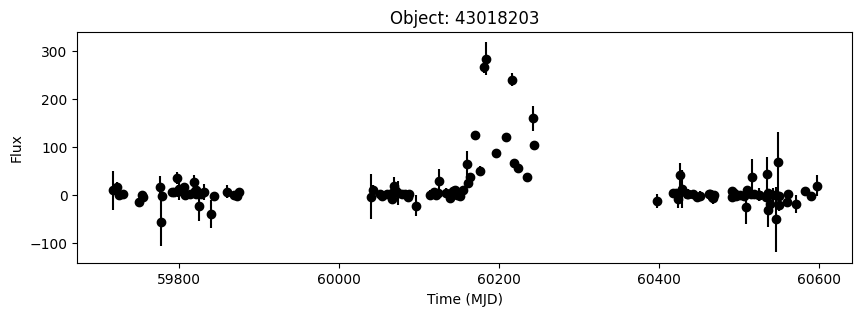

In [13]:
plotObject(43018203)

# Supernova Type Ibc:

In [14]:
objectid = 43018203

## listen to u band only

now plotting


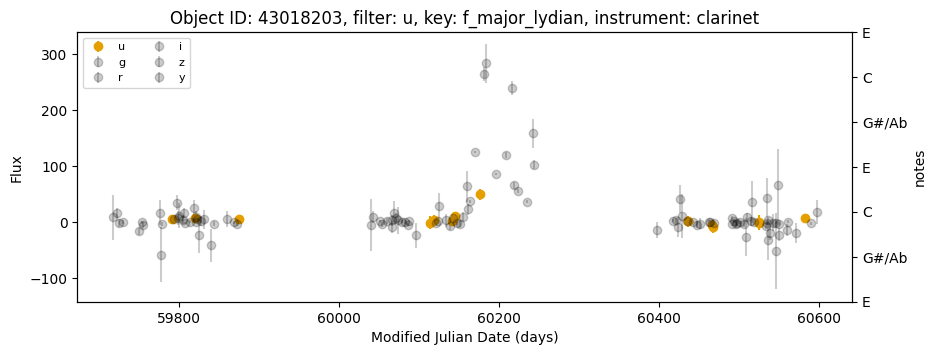

Saving to midi file


In [15]:
thisband = 'u'

singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=False, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_u.wav')
Audio('waveoutput_u.wav')

## listen to g band only

now plotting


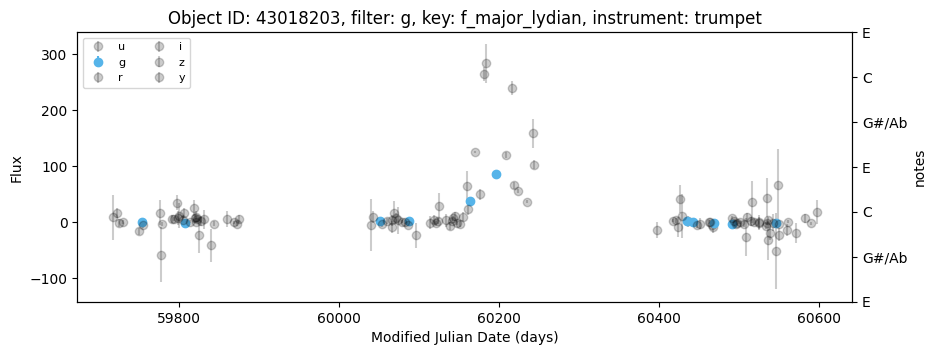

Saving to midi file


In [16]:
#@title Default title text
thisband = 'g'

singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_g.wav')
Audio('waveoutput_g.wav')

## listen to r band only

now plotting


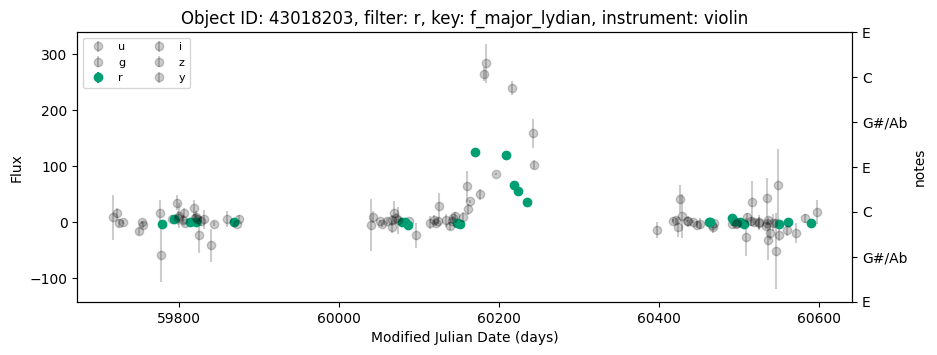

Saving to midi file


In [17]:
thisband = 'r'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_r.wav')
Audio('waveoutput_r.wav')

## listen to i band only

now plotting


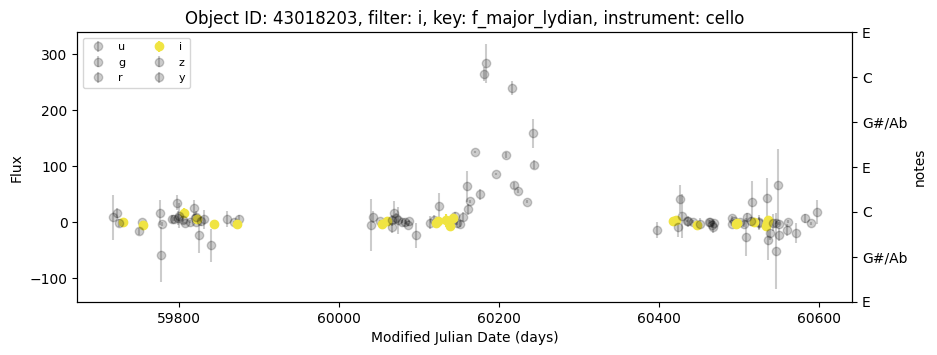

Saving to midi file


In [18]:
thisband = 'i'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_i.wav')
Audio('waveoutput_i.wav')

## listen to z band only

now plotting


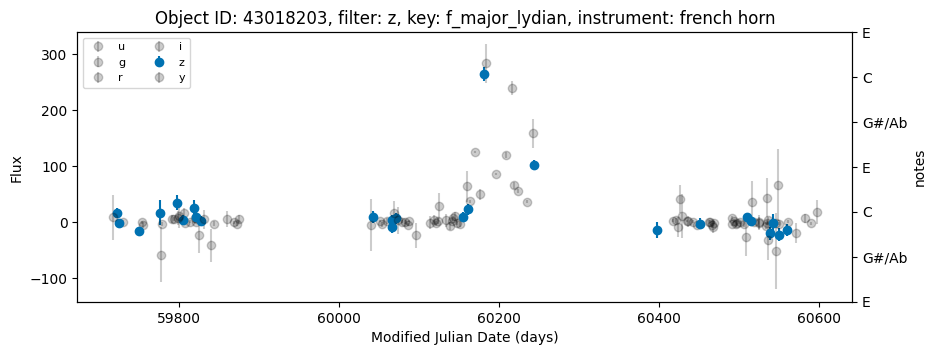

Saving to midi file


In [19]:
thisband = 'z'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_z.wav')
Audio('waveoutput_z.wav')

## listen to y band only

now plotting


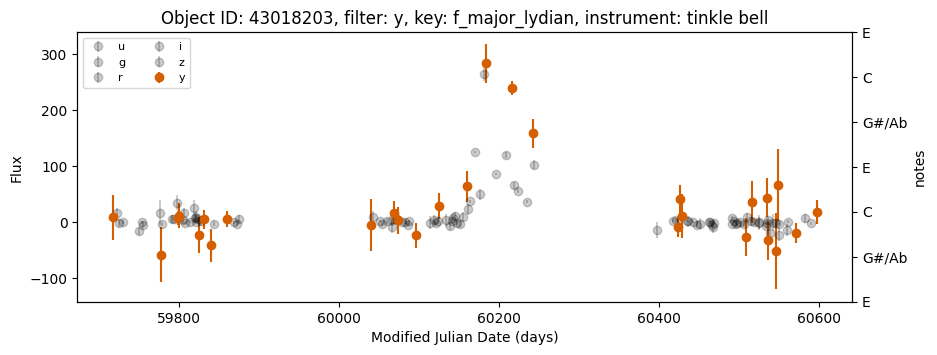

Saving to midi file


In [20]:
thisband = 'y'
singleSonification(data, objectid, filter=thisband, key='f_major_lydian',
                                instrument=INSTRUMENTS[thisband],
                                transposing=True, rescaled=True,
                                save=False, plot=True, colab=True,
                   diagonsticplots=False)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_y.wav')
Audio('waveoutput_y.wav')

----

# all violins

now plotting


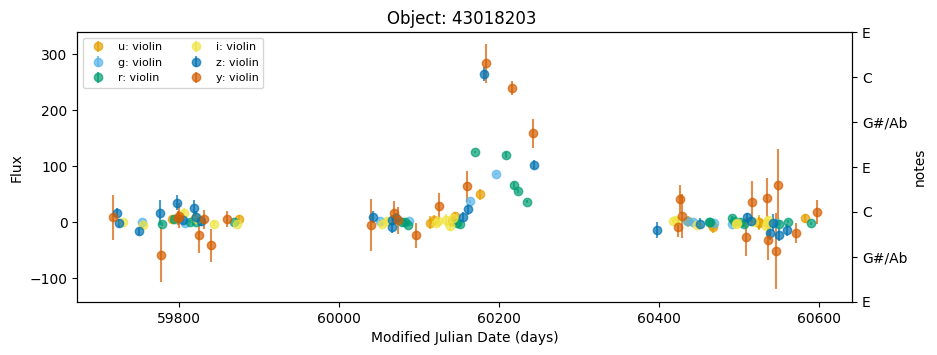

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [21]:
#----Sonification Knobs
temp_instruments = {p:'violin' for p in FILTERS}
#----

multiSonification(data, objectid,
                                instruments=temp_instruments,
                                transposing=True, rescaled=True,
                                drone=None, drum=None,
                                save=False, plot=True, colab=True)
fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_violins.wav')
Audio('waveoutput_violins.wav')

# All Different Instruments

In [22]:
for i in FILTERS:
  print(i, INSTRUMENTS[i])

u clarinet
g trumpet
r violin
i cello
z french horn
y tinkle bell


now plotting


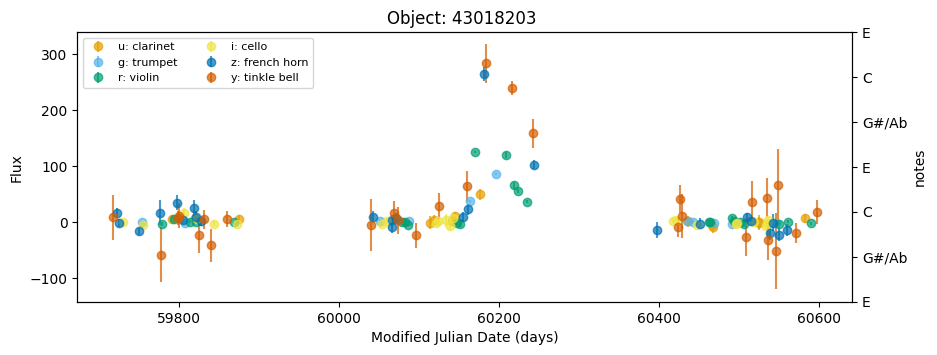

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [23]:
multiSonification(data, objectid, key='f_major_lydian',
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone=None, drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_transpose.wav')
Audio('waveoutput_transpose.wav')

g_minor
now plotting


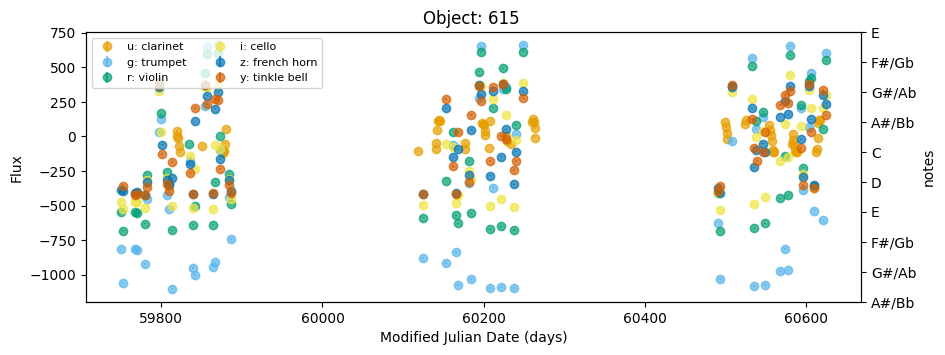

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [24]:
objectid = 615

if dataMETA[dataMETA['object_id'] == objectid]['ddf_bool'].values[0]:
  thiskey = 'g_minor'
else:
  thiskey = 'g_major'
print(thiskey)
multiSonification(data, objectid, key=thiskey,
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone=None, drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_transpose.wav')
Audio('waveoutput_transpose.wav')

# Drones

In [25]:
objectid = 43018203

now plotting


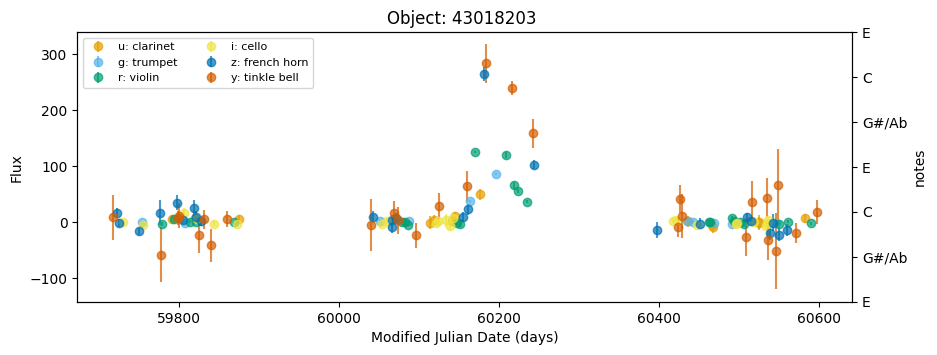

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [26]:
multiSonification(data, objectid, key='f_major_lydian',
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone="step", drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_dronestep.wav')
Audio('waveoutput_dronestep.wav')

now plotting


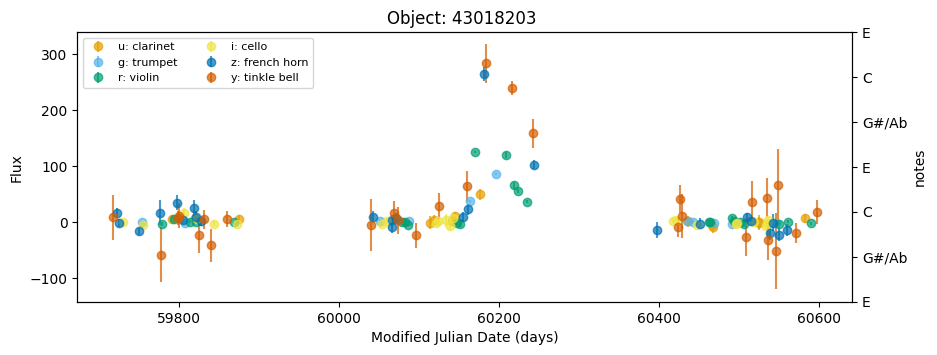

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [27]:
multiSonification(data, objectid,
                                instruments=INSTRUMENTS,
                                transposing=True, rescaled=True,
                                drone="gliss", drone_vol=100, drum=None,
                                save=False, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput_dronegliss.wav')
Audio('waveoutput_dronegliss.wav')

# drum

In [28]:
for i in FILTERS:
  print(i, INSTRUMENTS[i])

u clarinet
g trumpet
r violin
i cello
z french horn
y tinkle bell


now plotting


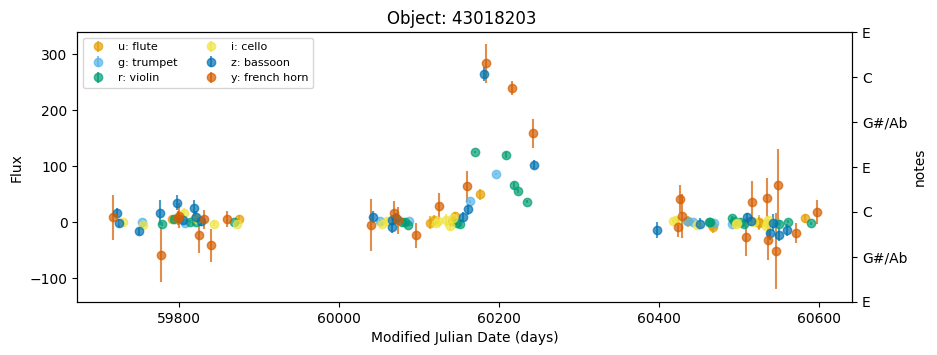

<Figure size 640x480 with 0 Axes>

Saving to midi file


In [29]:
multiSonification(data, objectid, key=configs.KEY,
                               drone="gliss", drum='crash cymbal 1',
                               save=True, plot=True, colab=True)

fs = FluidSynth(sound_font='font.sf2')
fs.midi_to_audio('midioutput.mid', 'waveoutput.wav')
Audio('waveoutput.wav')

## Testing cell for drone function

In [30]:
def drone_glissando(data=None, moon=True, PLOT=False):
    """
    Creates two lists that can be converted to MIDI tracks,
    one list for the drone sound, one for the base tone

    Parameters
    ---------------
    data: pandas dataframe
        input timeseries dataframe

    moon: boolean
        if True, moon phase used for drone frequency

    PLOT: boolean
        if True, diagnostic plot is plotted

    Returns
    ---------------
    drone_list, base_list: list
        zipped lists of drone and base time series
    """

    import sonifyFED.sonify.core as sonify
    if data is None:
        from .rr_utils import readdata
        data, _ = readdata()

    duration = int(data.mjd.max() - data.mjd.min() + 0.5)
    years = duration / 365.25  # duration in years (22 notes)
    months = duration / 30.5 #duration in months (RWC, 7/30/23)

    if moon:
        time = np.linspace(0, 15, int(22 * months + 0.5))
        y = list(range(1, 13)) + list(range(11, 1, -1))
        y = y * int(months + 0.5)
        y = list(range(3,1,-1)) + y #addition to account for days before new moon

    else:
        time = np.linspace(0, 15, int(22 * years + 0.5))
        y = list(range(1, 13)) + list(range(11, 1, -1))
        y = y * int(years + 0.5)

    data = list(zip(time, y))
    converted_data = sonify.convert_to_key(data, 'chromatic', number_of_octaves=1)
    x, y = zip(*converted_data)
    y_base = [36] * len(x)

    # make plots
    if PLOT:
        plt.plot(time, y_base, label="base")
        plt.plot(time, y, label="drone")
        plt.xlabel('Time (s)')
        plt.ylabel('note')
        plt.title('drone')
        plt.legend()
        plt.show()
    quantized_x = sonify.quantize_x_value(time, steps=0.01)
    drone_list = list(zip(quantized_x, y))
    base_list = list(zip(quantized_x, y_base))
    return drone_list, base_list

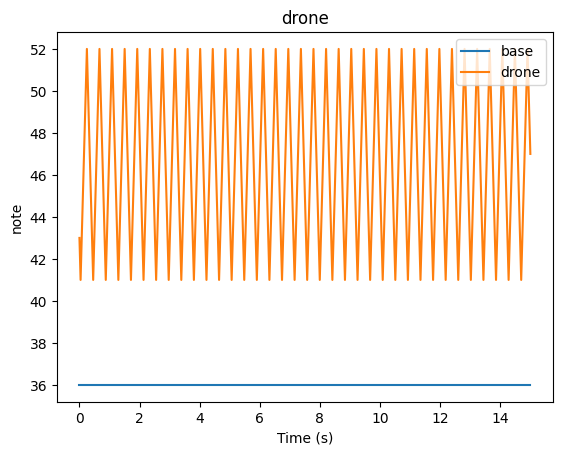

In [31]:
_ = drone_glissando(data=data, moon=True, PLOT=True)

In [32]:
def drone_glissando_2(data=None, moon=True, PLOT=False):
    """
    Creates two lists that can be converted to MIDI tracks,
    one list for the drone sound, one for the base tone

    Parameters
    ---------------
    data: pandas dataframe
        input timeseries dataframe

    moon: boolean
        if True, moon phase used for drone frequency

    PLOT: boolean
        if True, diagnostic plot is plotted

    Returns
    ---------------
    drone_list, base_list: list
        zipped lists of drone and base time series
    """

    import sonifyFED.sonify.core as sonify
    if data is None:
        from .rr_utils import readdata
        data, _ = readdata()

    duration = int(data.mjd.max() - data.mjd.min() + 0.5)
    years = duration / 365.25  # duration in years (22 notes)
    months = duration / 29.5 #duration in months (RWC, 7/30/23)

    if moon:
        time = np.linspace(0, 15, int(22*months + 0.5)*10)
        y = list(np.arange(1, 12.1,0.1)) + list(np.arange(1, 12.1, 0.1)[::-1])
        y = y * int(months + 0.5)
        y = list(np.arange(1,(7.4 / 29.5) * 22,0.1)[::-1]) + y #addition to account for days before new moon

    else:
        time = np.linspace(0, 15, int(22 * years + 0.5))
        y = list(range(1, 13)) + list(range(11, 1, -1))
        y = y * int(years + 0.5)

    data = list(zip(time, y))
    converted_data = sonify.convert_to_key(data, 'chromatic', number_of_octaves=1)
    x, y = zip(*converted_data)
    y_base = [36] * len(x)

    # make plots
    if PLOT:
        plt.plot(time, y_base, label="base")
        plt.plot(time, y, label="drone")
        plt.xlabel('Time (s)')
        plt.ylabel('note')
        plt.title('Drone')
        plt.xlim(0,1)
        plt.legend()
        plt.show()
    quantized_x = sonify.quantize_x_value(time, steps=0.01)
    drone_list = list(zip(quantized_x, y))
    base_list = list(zip(quantized_x, y_base))
    return drone_list, base_list

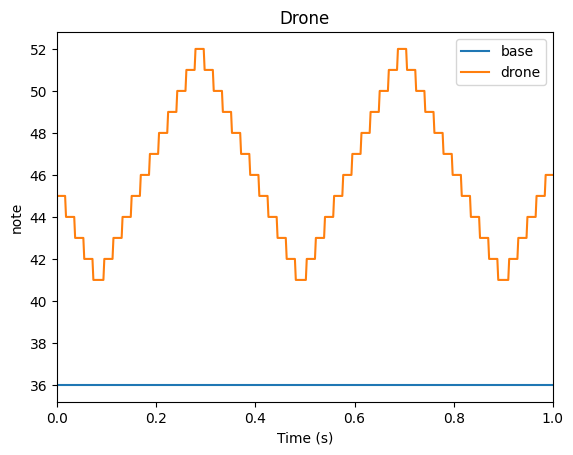

In [33]:
_ = drone_glissando_2(data=data, moon=True, PLOT=True)